In [1]:
# Imoport packages
import plotly.express as px
import pandas as pd 
import geopandas as gpd
import json

# Import function 
from maps import convert_shapefiles

----

## Neighborhoods map 
A map of Chicago broken down by neigborhoods.

Setps: 
1. Load geojson file with shape files for Chicago at the community level
2. Extract community names and build a data frame with data set
3. Build a map to the community level

In [2]:
# # Convert shapefile to feodata
# shape_file = "../data/geodata/Neighborhoods_2012b"
# convert_shapefiles(shape_file, ".shx")

In [3]:
# Load geodata
file = open("geodata/Boundaries_Community_Areas.geojson")
geo_communities = json.load(file)
file.close()

# type(geo_communities)
# geo_communities

# geo_communities = gpd.read_file("geodata/Boundaries_Community_Areas.geojson")


In [4]:
chicago_communities = []
for community in geo_communities["features"]:
    chicago_communities.append(community["properties"]["community"])

df = pd.DataFrame(chicago_communities, columns = ["community_name"])

# Data frame with sample data
df["trial_numbers"] = range(50, 50 + len(df))

In [5]:
# Documentation for choroplet maps 
# https://plotly.com/python/county-choropleth/

# Map!
fig = px.choropleth(
    # Data frame with variables of interest
    df, 
    # Geojson with geography 
    geojson = geo_communities, 
    # Variable that is to be mapped as color
    color = "trial_numbers",
    # Key in geojson to link with data frame
    featureidkey = "properties.community",
    locations = "community_name", 
    # Coordinate to center the map around
    center = dict(lat = 41.8781, lon = -87.6298), 
    # 
    projection = "mercator"
)

# Adjust zoom to display Chicago (based on the shapefile)
fig.update_geos(fitbounds="locations")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

-----

# Zip codes
1. Load geojson file with shape files for Chicago at the zip code level
2. Extract zip codes names and build a data frame with data set
3. Build a map to the zip code level

In [6]:
# Load geodata for zip codes
# shape_file = "../data/geodata/Neighborhoods_2012b"
file = open("geodata/Boundaries_ZIP_Codes.geojson")
geo_zip_codes = json.load(file)
file.close()

# geo_zip_codes

In [7]:
# geo_zip_codes = gpd.read_file("geodata/Boundaries_ZIP_Codes.geojson")


In [8]:
# Building a trial dataset 
chicago_zip_codes= []

for zip in geo_zip_codes["features"]:
    # print(zip["properties"]["zip"])
    chicago_zip_codes.append(zip["properties"]["zip"])

# Build a data set with all zip codes
df = pd.DataFrame(chicago_zip_codes, columns = ["zip"])
df["trial_numbers"] = range(50, 50 + len(df))
# df

In [9]:
# Map!
fig = px.choropleth(
    # Data frame with variables of interest
    df, 
    # Geojson with geography 
    geojson = geo_zip_codes, 
    # Variable that is to be mapped as color
    color = "trial_numbers",
    # Key in geojson to link with data frame
    featureidkey = "properties.zip",
    locations = "zip", 
    # Coordinate to center the map around
    center = dict(lat = 41.8781, lon = -87.6298), 
    # 
    projection = "mercator"
)

# Adjust zoom to display Chicago (based on the shapefile)
fig.update_geos(fitbounds="locations")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

-------

# Bus stops!!!

In [10]:
geo_bus_stops = gpd.read_file("geodata/CTA_Bus_Stops.geojson")
geo_bus_stops

,city,systemstop,public_nam,cross_st,pos,owlroutes,dir,street,routesstpg,geometry
0,CHICAGO,15189.0,Cicero & Berteau,BERTEAU (north leg),FS,None,SB,CICERO,"54,54A",POINT (-87.74751 41.95689)
1,CHICAGO,14545.0,Halsted & 119th Street,119TH STREET,FS,None,NB,HALSTED,"8A,108",POINT (-87.64179 41.67799)
2,CHICAGO,15046.0,Kedzie & Touhy,TOUHY,FS,None,NB,KEDZIE,11,POINT (-87.70897 42.01205)
3,CHICAGO,6280.0,Ashland & Irving Park,IRVING PARK,NS,None,NB,ASHLAND,"9,X9",POINT (-87.66892 41.95419)
4,CHICAGO,4484.0,Archer & Damen,DAMEN,NS,N62,SWB,ARCHER,62,POINT (-87.67518 41.83201)
...,...,...,...,...,...,...,...,...,...,...
10755,EVANSTON,14738.0,Dodge & Oakton,OAKTON,NS,None,SB,DODGE,93,POINT (-87.69961 42.02666)
10756,CHICAGO,5563.0,Milwaukee & Wisner,WISNER,NS,None,NWB,MILWAUKEE,56,POINT (-87.71428 41.93338)
10757,CHICAGO,9910.0,Northwest Hwy & Overhill,OVERHILL,FS,None,NWB,NORTHWEST HWY,68,POINT (-87.81891 42.00458)
10758,EVANSTON,17295.0,Sheridan & Foster,FOSTER,FS,None,SB,SHERIDAN,201,POINT (-87.67734 42.05372)


In [11]:
# Documentation for scatterplots on maps
# https://plotly.com/python/scatter-plots-on-maps/
import plotly.graph_objects as go
import pandas as pd

fig = px.scatter_geo(geo_bus_stops, 
                lat = geo_bus_stops.geometry.y, 
                lon = geo_bus_stops.geometry.x, 
                hover_name = "public_nam")


fig.update_geos(fitbounds="locations")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

----------

## Bus routes!!

Neighborhoods, zip codes and bus stations are done! 
Let's do bus routes now 🤠

In [12]:
import pathlib
pathlib.Path("geodata/CTA_BusRoutes.shx").is_file()


True

In [16]:
# Load data
# shape_file = "../data/CTA_BusRoutes_geodata/CTA_BusRoutes.shx"
# gpd.options.io_engine = "pyogrio"

import fsspec
path = "geodata/CTA_BusRoutes__2_.zip"
with fsspec.open(path) as file:
    geo_bus_routes = gpd.read_file(file)

geo_bus_routes

,ROUTE,ROUTE0,NAME,WKDAY,SAT,SUN,SHAPE_LEN,geometry
0,12,012,ROOSEVELT,1,1,1,62586.111408,"MULTILINESTRING ((1170944.365 1894917.516, 117..."
1,121,121,UNION/STREETERVILLE EXPRESS,1,0,0,24090.823988,"MULTILINESTRING ((1177256.972 1902694.559, 117..."
2,1,001,BRONZEVILLE/UNION STATION,1,0,0,34690.953676,"MULTILINESTRING ((1177767.298 1881817.345, 117..."
3,108,108,HALSTED/95TH,1,0,0,71888.990825,"MULTILINESTRING ((1187238.580 1818029.606, 118..."
4,11,011,LINCOLN,1,1,1,24694.573889,"MULTILINESTRING ((1159525.760 1931136.456, 115..."
...,...,...,...,...,...,...,...,...
123,120,120,OGILVIE/STREETERVILLE EXPRESS,1,0,0,19816.037215,"MULTILINESTRING ((1177256.972 1902694.559, 117..."
124,126,126,JACKSON,1,1,1,67746.952693,"MULTILINESTRING ((1136605.121 1898072.170, 113..."
125,20,020,MADISON,1,1,1,54335.296018,"MULTILINESTRING ((1136594.654 1899387.714, 113..."
126,128,128,SOLDIER FIELD EXPRESS,0,0,0,24871.988685,"MULTILINESTRING ((1179372.762 1894217.397, 117..."


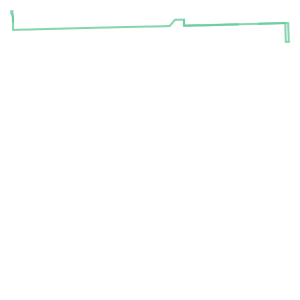

In [33]:
# If I extract the geometry attribute and display it, it shows the route
geo_bus_routes["geometry"][0]

In [34]:
geo_bus_routes["geometry"][0].geoms[0].xy

(array('d', [1170944.3649511747, 1171066.906700842, 1171088.6970115937, 1171222.1340806745, 1171366.465813011, 1171535.3119320087, 1171693.262731593, 1171815.8336806744, 1171870.3096215911, 1171922.0614865944, 1171984.6794715934, 1172104.4971453436, 1172172.5921535082, 1172344.161692258, 1172502.1124918424, 1172621.9593650103, 1172714.568431761, 1172899.7570377588, 1173063.155004926, 1173098.564054843, 1173163.9353151768, 1173305.5429715924, 1173488.0075016767, 1173566.9975011759]),
 array('d', [1894917.515639022, 1894922.1386612728, 1894922.3128735274, 1894927.0234940276, 1894931.8223689422, 1894936.8184219375, 1894941.7285171077, 1894942.7111266926, 1894943.148461774, 1894943.5638152733, 1894947.7104605213, 1894952.3170786053, 1894952.8643216044, 1894957.8879336044, 1894962.803278111, 1894963.7684992775, 1894964.5148888603, 1894969.6523457766, 1894974.6155904382, 1894974.901679106, 1894975.4295651913, 1894980.218269527, 1894985.3386661112, 1894985.9781005234]))

In [36]:
gpd.GeoSeries.plot(s = geo_bus_routes["geometry"][0], 
                   cmap = "tab10")

TypeError: GeoSeries.plot() missing 1 required positional argument: 'self'

In [ ]:
# identify data type of the route

import shapely.geometry

isinstance(geo_bus_routes["geometry"][0], 
           shapely.geometry.multilinestring.MultiLineString)

# type(geo_bus_routes["geometry"][0])

True

In [23]:
# Documentation for Lines on Maps from GeoPandas
# https://plotly.com/python/lines-on-maps/
import numpy as np

lats = []
lons = []
names = []

# Break down multilinestrings into lists that plotly can parse 
for _, route in geo_bus_routes.iterrows():
    # Extract multiline from route 
    route_linestrings = route["geometry"].geoms

    for linestring in route_linestrings:
        x, y = linestring.xy
        lats = np.append(lats, y)
        lons = np.append(lons, x)
        names = np.append(names, [route["NAME"]]*len(y))
        lats = np.append(lats, None)
        lons = np.append(lons, None)
        names = np.append(names, None)

fig.update_geos(fitbounds="locations")


In [22]:
# Documentation for lines on maps in python 
# https://plotly.com/python/lines-on-maps/
fig = px.line_geo(lat = lats, 
                  lon = lons, 
                  hover_name = names)

fig.update_geos(fitbounds="locations")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()